# **COGNIFYZ TECHNOLOGY INTERNSHIP TASKS**

# **LEVEL 2**

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset to inspect its structure and contents

In [15]:
dataset_path = 'Dataset.csv'
data = pd.read_csv(dataset_path)


# Display the first few rows and basic info of the dataset

In [16]:
data.head(3)

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270


In [17]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9551 entries, 0 to 9550
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Restaurant ID         9551 non-null   int64  
 1   Restaurant Name       9551 non-null   object 
 2   Country Code          9551 non-null   int64  
 3   City                  9551 non-null   object 
 4   Address               9551 non-null   object 
 5   Locality              9551 non-null   object 
 6   Locality Verbose      9551 non-null   object 
 7   Longitude             9551 non-null   float64
 8   Latitude              9551 non-null   float64
 9   Cuisines              9542 non-null   object 
 10  Average Cost for two  9551 non-null   int64  
 11  Currency              9551 non-null   object 
 12  Has Table booking     9551 non-null   object 
 13  Has Online delivery   9551 non-null   object 
 14  Is delivering now     9551 non-null   object 
 15  Switch to order menu 

In [18]:
data_cleaned = data.dropna(subset=['Cuisines'])
data_cleaned = data_cleaned.drop_duplicates(keep='first')

# Task 1 : Restaurant Ratings

**Q. Analyze the distribution of aggregate ratings and determine the most common rating range.**

Rating Range Distribution:
Rating Range
3-4    4583
0-1    2148
2-3    1430
4-5    1378
1-2       3
Name: count, dtype: int64

Most common rating range: 3-4 with 4583 restaurants.


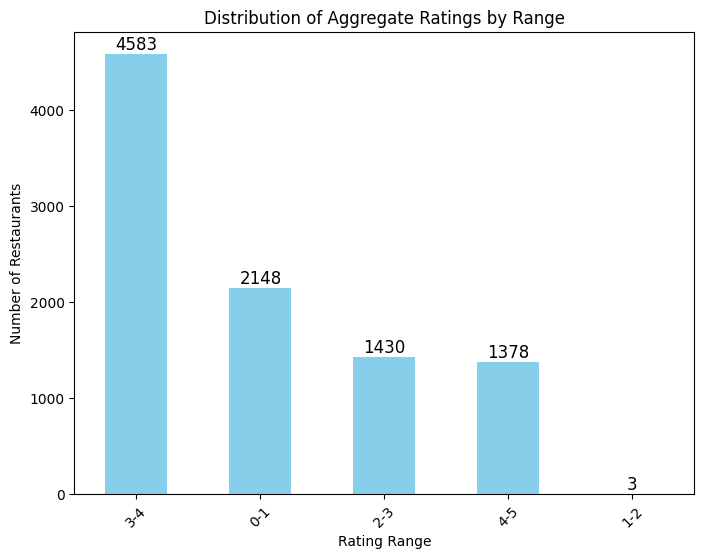

In [19]:
rating_bins = [0, 1, 2, 3, 4, 5]

rating_labels = ['0-1', '1-2', '2-3', '3-4', '4-5']

data_cleaned['Rating Range'] = pd.cut(data_cleaned['Aggregate rating'], bins=rating_bins, labels=rating_labels, right=False)

rating_range_counts = data_cleaned['Rating Range'].value_counts()

print("Rating Range Distribution:")
print(rating_range_counts)

most_common_range = rating_range_counts.idxmax()
most_common_count = rating_range_counts.max()

print(f"\nMost common rating range: {most_common_range} with {most_common_count} restaurants.")

plt.figure(figsize=(8, 6))
ax = rating_range_counts.plot(kind='bar', color='skyblue')

for i, count in enumerate(rating_range_counts):
    ax.text(i, count + 1, str(count), ha='center', va='bottom', fontsize=12)  # Adding text above bars

plt.title('Distribution of Aggregate Ratings by Range')
plt.xlabel('Rating Range')
plt.ylabel('Number of Restaurants')
plt.xticks(rotation=45)
plt.show()


**Q. Calculate the average number of votes received by restaurants.**

In [20]:
data_cleaned['Votes'] = pd.to_numeric(data_cleaned['Votes'], errors='coerce')

average_votes = data_cleaned['Votes'].mean()

print(f"The average number of votes received by restaurants is: {average_votes:.2f}")


The average number of votes received by restaurants is: 156.77


# Task 2: Cuisine Combination

**Q. Identify the most common combinations of cuisines in the dataset.**

In [21]:
import itertools
from collections import Counter

data_cleaned['Cuisines'] = data_cleaned['Cuisines'].fillna('')
data_cleaned['Cuisines'] = data_cleaned['Cuisines'].str.split(', ')

cuisine_combinations = []

for cuisines_list in data_cleaned['Cuisines']:
    if isinstance(cuisines_list, list) and len(cuisines_list) > 1:
        combinations = [tuple(sorted(combo)) for combo in itertools.combinations(cuisines_list, 2)]
        cuisine_combinations.extend(combinations)

cuisine_combinations_count = Counter(cuisine_combinations)

print("Top 3 Most Common Combinations of Cuisines:")
for combo, count in cuisine_combinations_count.most_common(3):
    print(f"{combo}: {count}")

Top 3 Most Common Combinations of Cuisines:
('Chinese', 'North Indian'): 1784
('Mughlai', 'North Indian'): 832
('Fast Food', 'North Indian'): 485


**Q. Determine if certain cuisine combinations tend to have higher ratings.**

In [22]:
from collections import defaultdict

combination_ratings = defaultdict(lambda: {'rating_sum': 0, 'count': 0})

for _, row in data_cleaned.iterrows():
    cuisines_list = row['Cuisines']
    rating = row['Aggregate rating']
    
    if isinstance(cuisines_list, list) and len(cuisines_list) > 1:
        combinations = itertools.combinations(cuisines_list, 2)
        
        for combo in combinations:
            sorted_combo = tuple(sorted(combo))
            combination_ratings[sorted_combo]['rating_sum'] += rating
            combination_ratings[sorted_combo]['count'] += 1

average_ratings = {}
for combo, data in combination_ratings.items():
    average_ratings[combo] = data['rating_sum'] / data['count']

top_combos_by_rating = sorted(average_ratings.items(), key=lambda x: x[1], reverse=True)[:3]

print("Top 3 Cuisine Combinations with the Highest Average Ratings:")
for combo, avg_rating in top_combos_by_rating:
    print(f"{combo}: {avg_rating:.2f}")


Top 3 Cuisine Combinations with the Highest Average Ratings:
('European', 'Indian'): 4.90
('American', 'Caribbean'): 4.90
('BBQ', 'Breakfast'): 4.90


# Task 3: Geographic Analysis

**Q. Plot the locations of restaurants on a map using longitude and latitude coordinates.**

In [23]:
import folium

print(data_cleaned[['Restaurant Name', 'Latitude', 'Longitude']].head())

map_center = [data_cleaned['Latitude'].mean(), data_cleaned['Longitude'].mean()]
print(f"Map center is set to: {map_center}")

mymap = folium.Map(location=map_center, zoom_start=12)

for index, row in data_cleaned.iterrows():
    lat = row['Latitude']
    lon = row['Longitude']
    
    if pd.notnull(lat) and pd.notnull(lon):
        folium.Marker([lat, lon], popup=row['Restaurant Name']).add_to(mymap)
    else:
        print(f"Skipping marker for {row['Restaurant Name']} due to missing coordinates.")

mymap.save("restaurant_locations_map.html")

mymap


          Restaurant Name   Latitude   Longitude
0        Le Petit Souffle  14.565443  121.027535
1        Izakaya Kikufuji  14.553708  121.014101
2  Heat - Edsa Shangri-La  14.581404  121.056831
3                    Ooma  14.585318  121.056475
4             Sambo Kojin  14.584450  121.057508
Map center is set to: [np.float64(25.84853159488723), np.float64(64.27499746924892)]


**Q. Identify any patterns or clusters of restaurants in specific areas.**

In [24]:
from sklearn.cluster import DBSCAN

print(f"Total restaurants to cluster: {len(data_cleaned)}")

coords = data_cleaned[['Latitude', 'Longitude']].values

db = DBSCAN(eps=0.05, min_samples=5, metric='haversine').fit(np.radians(coords))

data_cleaned['Cluster'] = db.labels_

print(f"Number of clusters found: {len(set(db.labels_)) - (1 if -1 in db.labels_ else 0)}")
print(f"Number of noise points: {list(db.labels_).count(-1)}")

map_center = [data_cleaned['Latitude'].mean(), data_cleaned['Longitude'].mean()]
mymap = folium.Map(location=map_center, zoom_start=12)

for _, row in data_cleaned.iterrows():
   
    color = 'red' if row['Cluster'] == -1 else 'blue'
    folium.Marker([row['Latitude'], row['Longitude']], 
                  popup=row['Restaurant Name'], 
                  icon=folium.Icon(color=color)).add_to(mymap)

mymap.save("restaurant_clusters_map.html")

mymap


Total restaurants to cluster: 9542
Number of clusters found: 29
Number of noise points: 25


# Task 4: Restaurant Chains

**Q. Identify if there are any restaurant chains present in the dataset.**

In [25]:
chain_count=data_cleaned["Restaurant Name"].value_counts()
chain_count.head(10)

Restaurant Name
Cafe Coffee Day     83
Domino's Pizza      79
Subway              63
Green Chick Chop    51
McDonald's          48
Keventers           34
Pizza Hut           30
Giani               29
Baskin Robbins      28
Barbeque Nation     26
Name: count, dtype: int64

**Q. Analyze the ratings and popularity of different restaurant chains.**

In [26]:
chain_data = data_cleaned.groupby('Restaurant Name').agg(
    avg_rating=('Aggregate rating', 'mean'),
    total_votes=('Votes', 'sum')
).reset_index()

restaurant_counts = data_cleaned['Restaurant Name'].value_counts()
possible_chains = restaurant_counts[restaurant_counts > 1].index
chain_data = chain_data[chain_data['Restaurant Name'].isin(possible_chains)]

chain_data_sorted_by_votes = chain_data.sort_values(by='total_votes', ascending=False)

print("Restaurant Chains Sorted by Popularity and Rating:")
print(chain_data_sorted_by_votes[['Restaurant Name', 'avg_rating', 'total_votes']])


Restaurant Chains Sorted by Popularity and Rating:
                Restaurant Name  avg_rating  total_votes
663             Barbeque Nation    4.353846        28142
101   AB's - Absolute Barbecues    4.825000        13400
785                   Big Chill    4.475000        10853
2294                 Farzi Cafe    4.366667        10098
6980                   Truffles    3.950000         9682
...                         ...         ...          ...
2576               Garam Masala    0.000000            0
2722  Green Valley Chinese Food    0.000000            0
3291               Jyoti Sweets    0.000000            0
578                Bake Walkers    0.000000            0
123               Aap Ki Khatir    0.000000            0

[734 rows x 3 columns]
